In [1]:
%matplotlib notebook
import numpy as np
import numpy.linalg as la
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import axes3d
import matplotlib
matplotlib.rcParams.update({'font.size': 14})

import scipy.sparse as sp
import scipy.sparse.linalg as spla
from scipy.linalg import toeplitz, circulant
from scipy.stats import linregress as linreg

import scipy.fftpack as fft

import sympy as smp

from pytex import *

from scipy.integrate import quadrature as quad

from matplotlib import animation
animation.rcParams['animation.writer'] = 'ffmpeg'
from IPython.display import HTML

In [2]:
matplotlib.rcParams.update({'font.size': 12})

# 1

In [3]:
# Crank-Nicolson - 1D heat equation
def cnhteq(initial, a, b, boundary_a, boundary_b, 
                                    coeff=1, target_time=1, N=10, m=16):
    
    ts = np.linspace(0, target_time, N+1)
    xs = np.linspace(a, b, m+2)
    
    h = (b-a)/(m+1)
    k = target_time/N
    
    us = np.zeros((N+1,m+2))
    us[:,0] = boundary_a(ts)
    us[:,-1] = boundary_b(ts)
    us[0, 1:-1] = initial(xs[1:-1])
    
    A = .5*coeff*k/h**2 * sp.diags([ [-2]*m, [1]*(m-1), [1]*(m-1) ], offsets=[0,1,-1], format='csr')
    #forward = sp.eye(m) + A
    #backward = sp.eye(m) - A
    
    for i in range(1, N+1):
        rhs = (sp.eye(m) + A) @ us[i-1, 1:-1]
        rhs[0]  += coeff*k/h**2 * (us[i-1, 0] + us[i, 0])/2
        rhs[-1] += coeff*k/h**2 * (us[i-1, -1] + us[i, -1])/2
        us[i, 1:-1] = spla.spsolve(sp.eye(m) - A, rhs)
    return us, xs, ts

In [4]:
def f(x):
    return np.sin(np.pi*x/2) + .5*np.sin(2*np.pi*x)
def boundary_a(t):
    return np.zeros(t.shape)
def boundary_b(t):
    return np.exp(-np.pi**2 * t/4)
a, b = 0, 1
target_time = 1

def exact(x,t):
    return np.exp(-np.pi**2 * t/4)*np.sin(np.pi*x/2) + .5*np.exp(-4*np.pi**2 * t)*np.sin(2*np.pi*x)

In [5]:
us, xs, ts = cnhteq(f, a, b, boundary_a, boundary_b, 
                    coeff=1, target_time=target_time, N=40, m=16)

In [6]:
ms = [2**i+1 for i in range(4,10)]
Ns = [m+1 for m in ms]
errors = []

hs = [1/(m-1) for m in ms]
for m, N in zip(ms, Ns):
    us, xs, ts = cnhteq(f, a, b, boundary_a, boundary_b, 
                    coeff=1, target_time=target_time, N=N, m=m)
    u_true = exact(xs, target_time)
    errors += [la.norm(u_true-us[-1])/la.norm(u_true)]

In [26]:
hs

[0.0625, 0.03125, 0.015625, 0.0078125, 0.00390625, 0.001953125]

In [27]:
2**-8

0.00390625

<IPython.core.display.Javascript object>


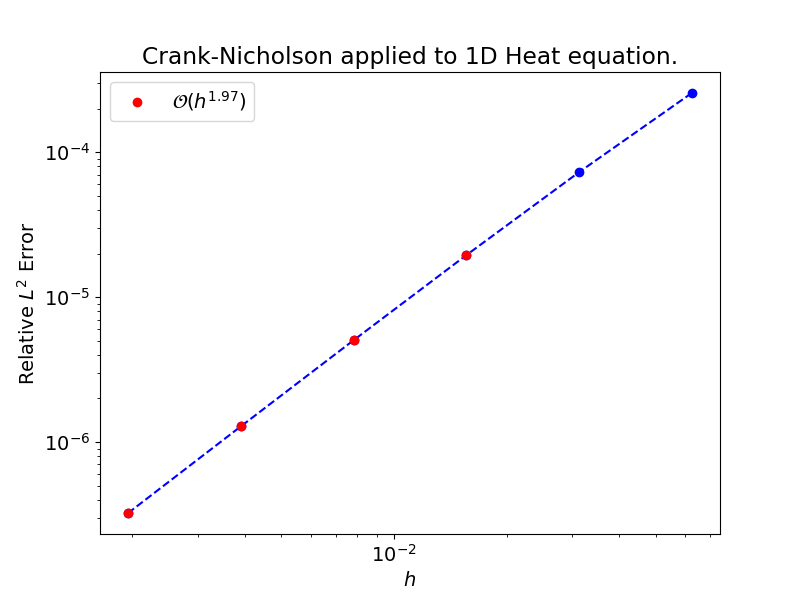

In [8]:
in_start, in_end = 2, len(hs)
order = linreg(np.log(hs[in_start:in_end]), np.log(errors[in_start:in_end]))[0]

plt.figure(figsize=(8,6))
plt.loglog(hs, errors, 'bo--')
plt.loglog(hs[in_start:in_end], errors[in_start:in_end], 'ro', label=('$\mathcal{O}(h^{%.2f})$'%order))
plt.legend()
plt.xlabel('$h$')
plt.ylabel('Relative $L^2$ Error')
plt.title('Crank-Nicholson applied to 1D Heat equation.')
plt.show()

In [21]:
N, m = 1000, 100
us, xs, ts = cnhteq(f, a, b, boundary_a, boundary_b, 
                    coeff=1, target_time=target_time, N=N, m=m)

X, T = np.meshgrid(xs, ts)

<IPython.core.display.Javascript object>


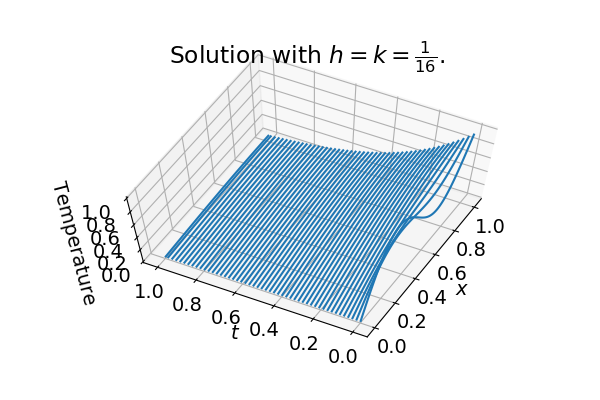

In [25]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111, projection='3d')
ax.plot_wireframe(X, T, us, ccount=0)
ax.set_xlabel('$x$')
ax.set_ylabel('$t$')
ax.set_zlabel('Temperature')
ax.set_title('Solution with $h=k=\\frac{1}{16}$.')
plt.show()

In [24]:
%%capture
fig, ax = plt.subplots(figsize=(6,4))
ax.set_xlim((np.min(xs), np.max(xs)))
ax.set_ylim((np.min(us), np.max(us)))

line, = ax.plot([], [], lw=2)
def init():
    line.set_data([], [])
    return (line,)
def animate(i):
    x = xs
    y = us[i]
    line.set_data(x, y)
    return (line,)
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=N, interval=80, blit=True)

In [ ]:
anim.save('hw6_p1.mp4', writer='ffmpeg', fps=30)

In [15]:
HTML(anim.to_jshtml())

# 2

In [28]:
# Crank-Nicolson - 1D heat equation
def bdf2_hteq(initial, a, b, boundary_a, boundary_b, 
                                    coeff=1, target_time=1, N=10, m=16):
    
    ts = np.linspace(0, target_time, N+1)
    xs = np.linspace(a, b, m+2, endpoint=True)
    
    h = (b-a)/(m+1)
    k = target_time/N
    
    us = np.zeros((N+1,m+2))
    us[:,0] = boundary_a(ts)
    us[:,-1] = boundary_b(ts)
    us[0, 1:-1] = initial(xs[1:-1])
    
    # one step of cn
    A = coeff*k/h**2 * sp.diags([ [-2]*m, [1]*(m-1), [1]*(m-1) ], offsets=[0,1,-1], format='csr')
    for i in range(1, 2):
        rhs = (sp.eye(m) + .5*A) @ us[i-1, 1:-1]
        rhs[0]  += coeff*k/h**2 * (us[i-1, 0] + us[i, 0])/2
        rhs[-1] += coeff*k/h**2 * (us[i-1, -1] + us[i, -1])/2
        us[i, 1:-1] = spla.spsolve(sp.eye(m) - .5*A, rhs)
    
    # BDF2
    for i in range(2, N+1):
        rhs = (4*us[i-1, 1:-1] - us[i-2, 1:-1])/3
        rhs[0]  += 2/3 * coeff*k/h**2 * us[i, 0]
        rhs[-1] += 2/3 * coeff*k/h**2 * us[i, -1]
        us[i, 1:-1] = spla.spsolve(sp.eye(m) - 2/3*A, rhs)
    
    return us, xs, ts

In [29]:
ms = [2**i+1 for i in range(4,10)]
Ns = [m+1 for m in ms]
errors = []

hs = [1/(m-1) for m in ms]
for m, N in zip(ms, Ns):
    us, xs, ts = bdf2_hteq(f, a, b, boundary_a, boundary_b, 
                    coeff=1, target_time=target_time, N=N, m=m)
    u_true = exact(xs, target_time)
    errors += [la.norm(u_true-us[-1])/la.norm(u_true)]

<IPython.core.display.Javascript object>


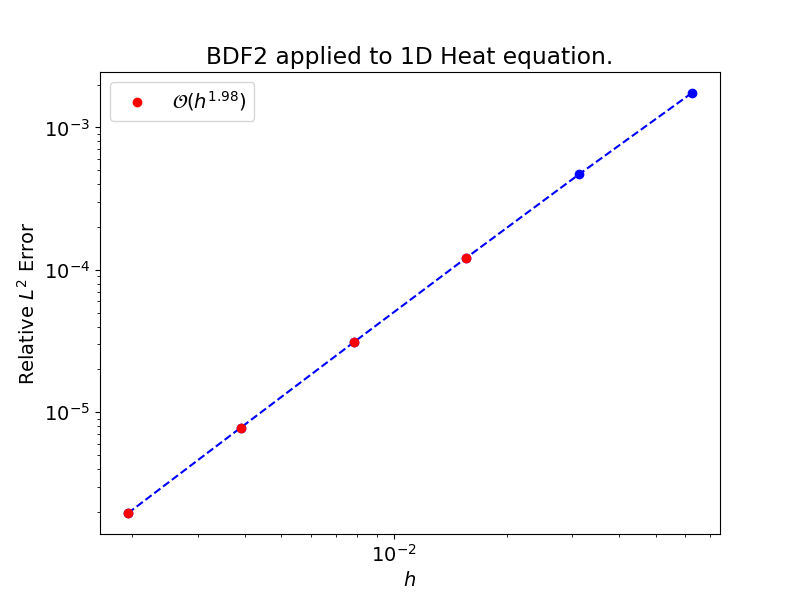

In [31]:
in_start, in_end = 2, len(hs)
order = linreg(np.log(hs[in_start:in_end]), np.log(errors[in_start:in_end]))[0]

plt.figure(figsize=(8,6))
plt.loglog(hs, errors, 'bo--')
plt.loglog(hs[in_start:in_end], errors[in_start:in_end], 'ro', label=('$\mathcal{O}(h^{%.2f})$'%order))
plt.legend()
plt.xlabel('$h$')
plt.ylabel('Relative $L^2$ Error')
plt.title('BDF2 applied to 1D Heat equation.')
plt.show()

In [ ]:
us, xs, ts = bdf2_hteq(f, a, b, boundary_a, boundary_b, 
                    coeff=1, target_time=target_time, N=18, m=17)

X, T = np.meshgrid(xs, ts)

In [ ]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111, projection='3d')
ax.plot_wireframe(X, T, us, ccount=0)
ax.set_xlabel('$x$')
ax.set_ylabel('$t$')
ax.set_zlabel('Temperature')
plt.show()

# 4

In [11]:
def RKN_wave(init_dis, init_vel, coeff=1, target_time=2*np.pi, N=10, m=16):
    ts = np.linspace(0, target_time, N+1)
    xs = np.linspace(0, 2*np.pi, m+1, endpoint=False)
    
    h = (2*np.pi)/(m+1)
    k = target_time/N
    
    us = np.zeros((N+1,m+1))
    us[0] = init_dis(xs)
    u_prime = init_vel(xs)
    
    A = sp.diags(
        [ [-30]*(m+1), [16]*(m-0), [16]*(m-0), [-1]*(m-1), [-1]*(m-1) ], 
        offsets=[0,1,-1, 2, -2], format='lil')
    A[ 0, -1] = 16
    A[ 0, -2] = -1
    A[ 1, -1] = -1
    A[-2,  0] = -1
    A[-1,  0] = 16
    A[-1,  1] = -1
    A *= coeff**2 / (12*h**2)
    A = A.tocsr()
    
    for i in range(1, N+1):
        d1 = A @ us[i-1]
        d2 = A @ (us[i-1] + k/2*u_prime + k**2/8*d1)
        d3 = A @ (us[i-1] + k*u_prime + k**2/2*d2)
        us[i] = us[i-1] + k*u_prime + k**2*(1/6*d1 + 1/3*d2)
        u_prime = u_prime + k*(1/6*d1 + 2/3*d2 + 1/6*d3)
        
    return us, xs, ts

In [12]:
def init_dis(x):
    return np.exp(-20*(x-np.pi/2)**2) + 3/2*np.exp(-20*(x-4*np.pi/3)**2)
def init_vel(x):
    return 0*x
exact = lambda x,t: init_dis(x)

In [13]:
N, m = 400, 200
us, xs, ts = RKN_wave(init_dis, init_vel, N=N, m=m)

In [6]:
%%capture
fig, ax = plt.subplots(figsize=(6,4))
ax.set_xlim((0, 2*np.pi))
ax.set_ylim((-1.6, 1.6))

line, = ax.plot([], [], lw=2)
def init():
    line.set_data([], [])
    return (line,)
def animate(i):
    x = xs
    y = us[i]
    line.set_data(x, y)
    return (line,)
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=N, interval=40, blit=True)

In [8]:
anim.save('hw6_p4.mp4', writer='ffmpeg', fps=30)

In [7]:
HTML(anim.to_jshtml())

In [14]:
N, m = 400, 200
us, xs, ts = RKN_wave(init_dis, init_vel, N=N, m=m)

X, T = np.meshgrid(xs, ts)

<IPython.core.display.Javascript object>


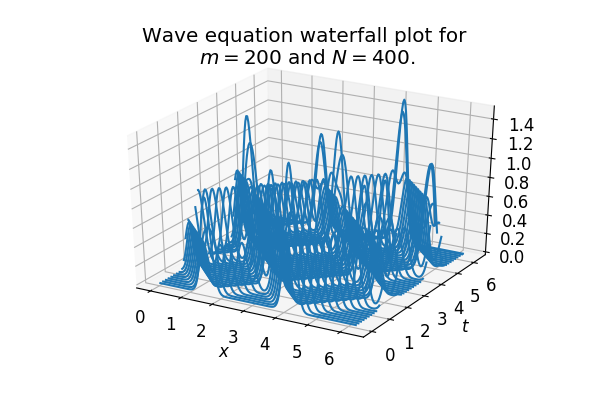

error = 5.22702e-05


<IPython.core.display.Javascript object>


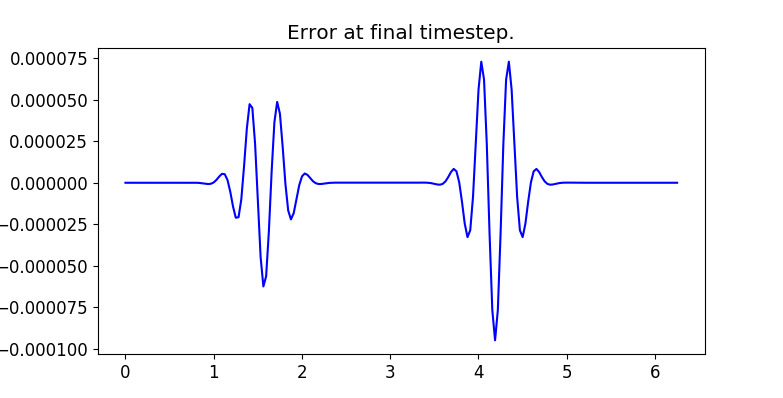

In [15]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111, projection='3d')
ax.plot_wireframe(X, T, us, ccount=0)
ax.set_xlabel('$x$')
ax.set_ylabel('$t$')
ax.set_title('Wave equation waterfall plot for \n$m=200$ and $N=400$.')
plt.show()

u_true = exact(xs, 0)
error = la.norm(u_true-us[-1])/la.norm(u_true)
print('error = %g' % error)

plt.figure(figsize=(6,4))
plt.plot(xs, us[-1]-u_true, 'b-')
plt.title("Error at final timestep.")
plt.show()

### 4(c) Extra Credit

In [4]:
def RKN_wave_FFT(init_dis, init_vel, coeff=1, target_time=2*np.pi, N=10, m=16):
    ts = np.linspace(0, target_time, N+1)
    xs = np.linspace(0, 2*np.pi, m+1, endpoint=False)
    
    h = (2*np.pi)/(m+1)
    k = target_time/N
    
    us = np.zeros((N+1,m+1))
    us[0] = init_dis(xs)
    u_prime = init_vel(xs)
    
    for i in range(1, N+1):
        d1 = coeff**2 * fft.diff(us[i-1], order=2)
        d2 = coeff**2 * fft.diff(us[i-1] + k/2*u_prime + k**2/8*d1, order=2)
        d3 = coeff**2 * fft.diff(us[i-1] + k*u_prime + k**2/2*d2, order=2)
        us[i] = us[i-1] + k*u_prime + k**2*(1/6*d1 + 1/3*d2)
        u_prime = u_prime + k*(1/6*d1 + 2/3*d2 + 1/6*d3)
        
    return us, xs, ts

In [5]:
N, m = 400, 200
us, xs, ts = RKN_wave_FFT(init_dis, init_vel, N=N, m=m)

X, T = np.meshgrid(xs, ts)

<IPython.core.display.Javascript object>


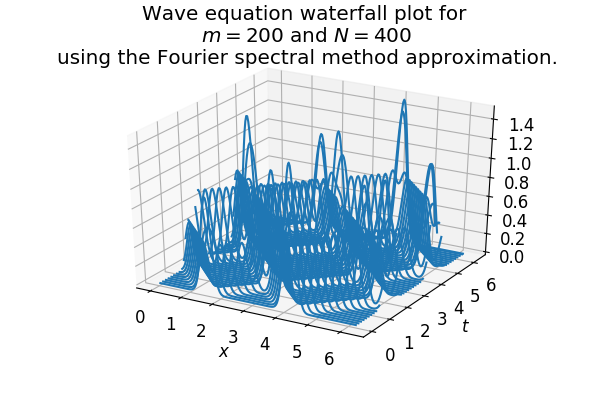

error = 8.55204e-06


<IPython.core.display.Javascript object>


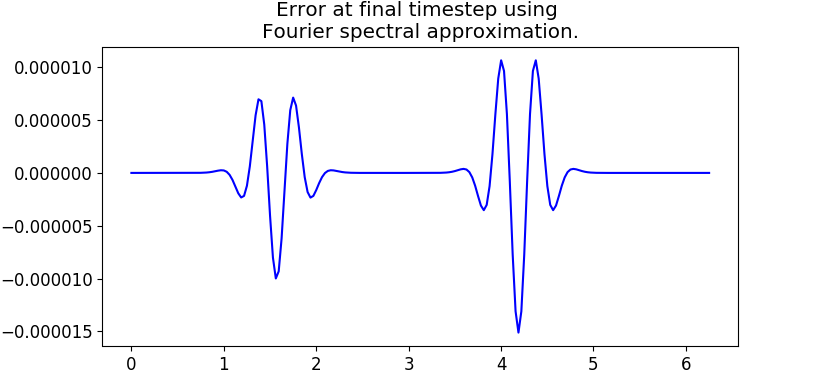

In [10]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111, projection='3d')
ax.plot_wireframe(X, T, us, ccount=0)
ax.set_xlabel('$x$')
ax.set_ylabel('$t$')
ax.set_title('Wave equation waterfall plot for \n$m=200$ and $N=400$ \nusing the Fourier spectral method approximation.')
plt.show()

u_true = exact(xs, 0)
error = la.norm(u_true-us[-1])/la.norm(u_true)
print('error = %g' % error)

plt.figure(figsize=(6,4))
plt.plot(xs, us[-1]-u_true, 'b-')
plt.title("Error at final timestep using \nFourier spectral approximation.")
plt.show()

In [26]:
%%capture
fig, ax = plt.subplots(figsize=(6,4))
ax.set_xlim((0, 2*np.pi))
ax.set_ylim((-1.6, 1.6))

line, = ax.plot([], [], lw=2)
def init():
    line.set_data([], [])
    return (line,)
def animate(i):

    x = xs
    y = us[i]
    line.set_data(x, y)
    return (line,)
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=N, interval=40, blit=True)

In [27]:
HTML(anim.to_jshtml())

# 5

In [18]:
def RKN_wave_sys(init_dis, int_init_vel, coeff=1, target_time=2*np.pi, N=10, m=16):
    ts = np.linspace(0, target_time, N+1)
    xs = np.linspace(0, 2*np.pi, m+1, endpoint=False)

    h = (2*np.pi)/(m+1)
    k = target_time/N

    '''
    us = np.zeros((N+1,m+1))
    us[0] = init_dis(xs)
    vs = np.zeros((N+1,m+1))
    vs[0] = init_vel(xs)
    '''
    # qs contain us in the first m+1 cols and vs in the rest
    qs = np.zeros( (N+1,(m+1)*2) )
    qs[0,:m+1] = init_dis(xs)
    qs[0,m+1:] = int_init_vel(xs)

    A = sp.diags(
            [ [1]*(m-1), [-8]*(m-0), [8]*(m-0), [-1]*(m-1) ], 
            offsets=[-2, -1, 1, 2], format='lil')
    A[ 0, -1] = -8
    A[ 0, -2] =  1
    A[ 1, -1] =  1
    A[-2,  0] = -1
    A[-1,  0] =  8
    A[-1,  1] = -1
    A *= -1 / (12*h)
    A = sp.bmat([[None, A],[coeff**2*A, None]]).tocsr()

    for i in range(1,N+1):
        k1 = k * A@ qs[i-1]
        k2 = k * A@(qs[i-1] + k1/2)
        k3 = k * A@(qs[i-1] + k2/2)
        k4 = k * A@(qs[i-1] + k3)
        qs[i] = qs[i-1] + k1/6 + k2/3 + k3/3 + k4/6

    return qs[:,:m+1], xs, ts 

In [23]:
int_init_vel = init_vel
#int_init_vel = lambda x: np.ones(x.shape)
coeff = 1
target_time = 2*np.pi
N, m = 400, 200
us, xs, ts = RKN_wave_sys(init_dis, int_init_vel, coeff=1, target_time=target_time, N=N, m=m)

X, T = np.meshgrid(xs, ts)

<IPython.core.display.Javascript object>


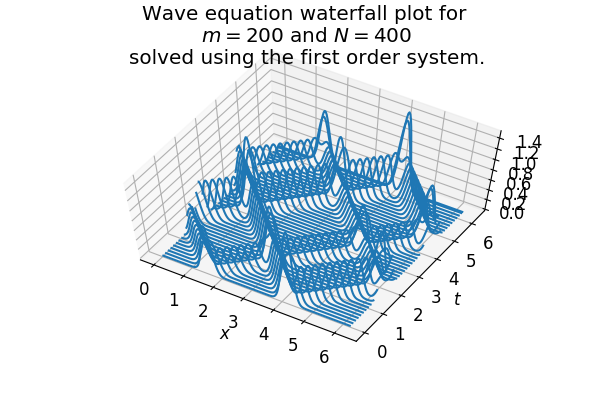

error = 0.00145634


<IPython.core.display.Javascript object>


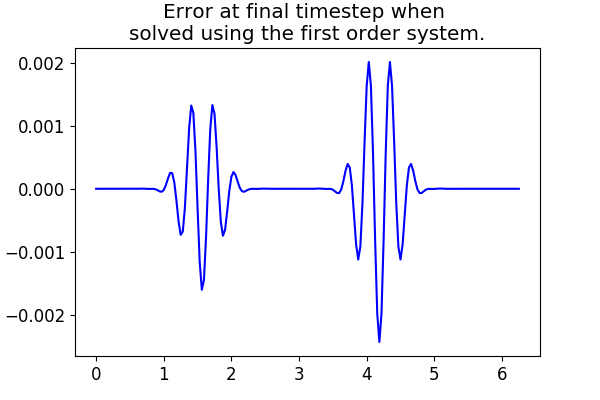

In [25]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111, projection='3d')
ax.plot_wireframe(X, T, us, ccount=0)
ax.set_xlabel('$x$')
ax.set_ylabel('$t$')
ax.set_title('Wave equation waterfall plot for \n$m=200$ and $N=400$ \nsolved using the first order system.')
plt.show()

u_true = exact(xs, 0)
error = la.norm(u_true-us[-1])/la.norm(u_true)
print('error = %g' % error)

plt.figure(figsize=(6,4))
plt.plot(xs, us[-1]-u_true, 'b-')
plt.title("Error at final timestep when \nsolved using the first order system.")
plt.show()

In [38]:
%%capture
fig, ax = plt.subplots(figsize=(6,4))
ax.set_xlim((0, 2*np.pi))
ax.set_ylim((-1.6, 1.6))

line, = ax.plot([], [], lw=2)
def init():
    line.set_data([], [])
    return (line,)
def animate(i):
    x = xs
    y = us[i]
    line.set_data(x, y)
    return (line,)
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=N, interval=40, blit=True)
plt.show()

In [39]:
HTML(anim.to_jshtml())

### 5(e) Extra Credit

In [28]:
def RKN_wave_sys_FFT(init_dis, int_init_vel, coeff=1, target_time=2*np.pi, N=10, m=16):
    ts = np.linspace(0, target_time, N+1)
    xs = np.linspace(0, 2*np.pi, m+1, endpoint=False)

    h = (2*np.pi)/(m+1)
    k = target_time/N

    # qs contain us in the first m+1 cols and vs in the rest
    qs = np.zeros( (N+1,(m+1)*2) )
    qs[0,:m+1] = init_dis(xs)
    qs[0,m+1:] = int_init_vel(xs)

    A = sp.diags(
            [ [1]*(m-1), [-8]*(m-0), [8]*(m-0), [-1]*(m-1) ], 
            offsets=[-2, -1, 1, 2], format='lil')
    A[ 0, -1] = -8
    A[ 0, -2] =  1
    A[ 1, -1] =  1
    A[-2,  0] = -1
    A[-1,  0] =  8
    A[-1,  1] = -1
    A *= -1 / (12*h)
    A = sp.bmat([[None, A],[coeff**2*A, None]]).tocsr()
    
    k1 = np.zeros(qs[0].shape)
    k2 = np.zeros(qs[0].shape)
    k3 = np.zeros(qs[0].shape)
    k4 = np.zeros(qs[0].shape)

    for i in range(1,N+1):
        tmp = qs[i-1]
        k1[:m+1] = -k*           fft.diff(tmp[m+1:])
        k1[m+1:] = -k*coeff**2 * fft.diff(tmp[:m+1])
        
        #k2 = k * A@(qs[i-1] + k1/2)
        tmp = qs[i-1] + k1/2
        k2[:m+1] = -k*           fft.diff(tmp[m+1:])
        k2[m+1:] = -k*coeff**2 * fft.diff(tmp[:m+1])
        
        #k3 = k * A@(qs[i-1] + k2/2)
        tmp = qs[i-1] + k2/2
        k3[:m+1] = -k*           fft.diff(tmp[m+1:])
        k3[m+1:] = -k*coeff**2 * fft.diff(tmp[:m+1])
        
        #k4 = k * A@(qs[i-1] + k3)
        tmp = qs[i-1] + k3
        k4[:m+1] = -k*           fft.diff(tmp[m+1:])
        k4[m+1:] = -k*coeff**2 * fft.diff(tmp[:m+1])
        
        qs[i] = qs[i-1] + k1/6 + k2/3 + k3/3 + k4/6

    return qs[:,:m+1], xs, ts 

In [29]:
int_init_vel = init_vel
coeff = 1
target_time = 2*np.pi
N, m = 400, 200
us, xs, ts = RKN_wave_sys_FFT(init_dis, int_init_vel, coeff=1, target_time=target_time, N=N, m=m)

X, T = np.meshgrid(xs, ts)

<IPython.core.display.Javascript object>


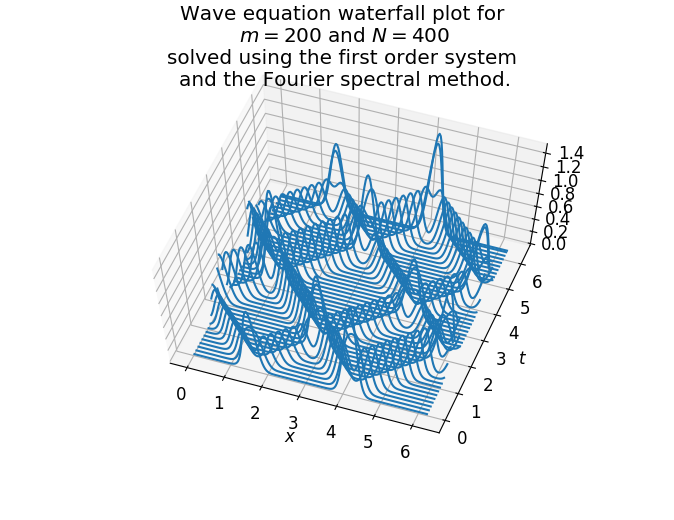

error = 3.40471e-05


<IPython.core.display.Javascript object>


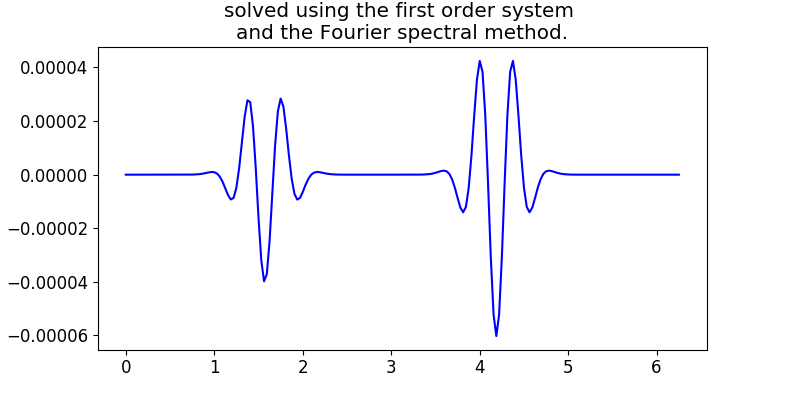

In [31]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111, projection='3d')
ax.plot_wireframe(X, T, us, ccount=0)
ax.set_xlabel('$x$')
ax.set_ylabel('$t$')
ax.set_title('Wave equation waterfall plot for \n$m=200$ and $N=400$ \nsolved using the first order system \nand the Fourier spectral method.')
plt.show()

u_true = exact(xs, 0)
error = la.norm(u_true-us[-1])/la.norm(u_true)
print('error = %g' % error)

plt.figure(figsize=(6,4))
plt.plot(xs, us[-1]-u_true, 'b-')
plt.title("Error at final timestep when \nsolved using the first order system \nand the Fourier spectral method.")
plt.show()